### 1. Predicting Employee Exit

---


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
df=pd.read_csv('https://raw.githubusercontent.com/tranghth-lux/data-science-complete-tutorial/master/Data/HR_comma_sep.csv.txt')
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,sales,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low


In [ ]:
left=df[df.left==1]
len(left)

3571

In [ ]:
retained=df[df.left==0]
len(retained)

11428

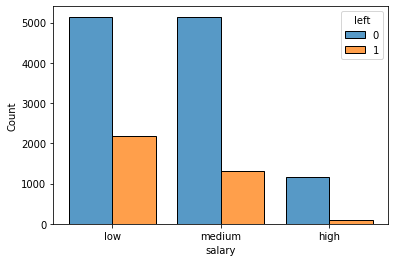

In [ ]:
sns.histplot(df,x='salary',hue='left',multiple="dodge",stat='count',shrink=0.8)

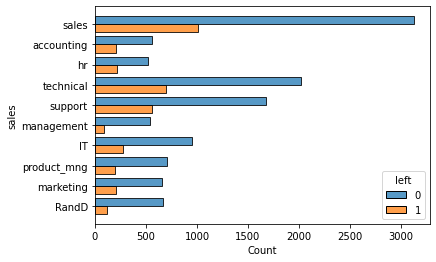

In [ ]:
sns.histplot(df,y='sales',hue='left',multiple="dodge",stat='count',shrink=0.8)

In [ ]:
df.groupby('left').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,promotion_last_5years
left,,,,,,,
0,0.666810,0.715473,3.786664,199.060203,3.380032,0.175009,0.026251
1,0.440098,0.718113,3.855503,207.419210,3.876505,0.047326,0.005321


In [ ]:
newdf=df[['satisfaction_level','average_montly_hours','promotion_last_5years','salary']]
newdf.head()

,satisfaction_level,average_montly_hours,promotion_last_5years,salary
0,0.38,157,0,low
1,0.80,262,0,medium
2,0.11,272,0,medium
3,0.72,223,0,low
4,0.37,159,0,low


In [ ]:
dummies=pd.get_dummies(newdf.salary,prefix='salary')

In [ ]:
dummies.head()

,salary_high,salary_low,salary_medium
0,0,1,0
1,0,0,1
2,0,0,1
3,0,1,0
4,0,1,0


In [ ]:
newdf=pd.concat([newdf,dummies],axis=1)
newdf.drop('salary',axis=1,inplace=True)
newdf.head()

,satisfaction_level,average_montly_hours,promotion_last_5years,salary_high,salary_low,salary_medium
0,0.38,157,0,0,1,0
1,0.80,262,0,0,0,1
2,0.11,272,0,0,0,1
3,0.72,223,0,0,1,0
4,0.37,159,0,0,1,0


In [ ]:
x=newdf
y=df.left

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC


In [ ]:
cross_val_score(LogisticRegression(),x,y).mean()

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


0.7763186395465156

In [ ]:
cross_val_score(SVC(),x,y).mean()

0.7791187062354118

In [ ]:
cross_val_score(DecisionTreeClassifier(),x,y).mean()

0.9278635100589085

### 2. Estimate the total compensation to be provided to an employee

___




In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab import files
files.upload()

Saving train_set.csv to train_set.csv


In [ ]:
df=pd.read_csv('train_set.csv')
len(df)

287836

In [ ]:
df.head()

,Year,OGC,OG,DC,Dept,UC,Union,JF,Job,EI,Salaries,Overtime,H/D,YT,Total_Compensation
0,2015,4,Community Health,DPH,Public Health,250,"SEIU - Health Workers, Local 1021",Med Therapy & Auxiliary,Morgue Attendant,6725,12196,0,0.00,Calendar,16158
1,2013,4,Community Health,DPH,Public Health,39,"Stationary Engineers, Local 39",Journeyman Trade,Stationary Engineer,25058,74639,2820,12703.31,Fiscal,115784
2,2015,6,General Administration & Finance,ASR,Assessor/Recorder,21,"Prof & Tech Engineers - Miscellaneous, Local 21",Appraisal & Taxation,Senior Real Property Appraiser,46108,100554,0,12424.50,Calendar,144708
3,2016,1,Public Protection,POL,Police,911,Police Officers' Association,Police Services,Sergeant 3,33369,140164,52754,13043.87,Fiscal,242323
4,2013,2,"Public Works, Transportation & Commerce",HHP,PUC Hetch Hetchy,21,"Prof & Tech Engineers - Miscellaneous, Local 21",Information Systems,IS Engineer-Journey,28684,58813,0,7655.28,Calendar,82106


In [ ]:
df.drop_duplicates(inplace=True)

In [ ]:
len(df)

287151

In [ ]:
df.isna().sum()

Year                   0
OGC                    0
OG                     0
DC                     0
Dept                   0
UC                     0
Union                 36
JF                    38
Job                    0
EI                     0
Salaries               0
Overtime               0
H/D                    0
YT                     0
Total_Compensation     0
dtype: int64

In [ ]:
df=df[df.Union.notna()]
df=df[df.JF.notna()]


In [ ]:
df.isna().sum()

Year                  0
OGC                   0
OG                    0
DC                    0
Dept                  0
UC                    0
Union                 0
JF                    0
Job                   0
EI                    0
Salaries              0
Overtime              0
H/D                   0
YT                    0
Total_Compensation    0
dtype: int64

In [ ]:
df.dtypes

Year                    int64
OGC                     int64
OG                     object
DC                     object
Dept                   object
UC                      int64
Union                  object
JF                     object
Job                    object
EI                      int64
Salaries                int64
Overtime                int64
H/D                   float64
YT                     object
Total_Compensation      int64
dtype: object

In [ ]:
df.head()

,Year,OGC,OG,DC,Dept,UC,Union,JF,Job,EI,Salaries,Overtime,H/D,YT,Total_Compensation
0,2015,4,Community Health,DPH,Public Health,250,"SEIU - Health Workers, Local 1021",Med Therapy & Auxiliary,Morgue Attendant,6725,12196,0,0.00,Calendar,16158
1,2013,4,Community Health,DPH,Public Health,39,"Stationary Engineers, Local 39",Journeyman Trade,Stationary Engineer,25058,74639,2820,12703.31,Fiscal,115784
2,2015,6,General Administration & Finance,ASR,Assessor/Recorder,21,"Prof & Tech Engineers - Miscellaneous, Local 21",Appraisal & Taxation,Senior Real Property Appraiser,46108,100554,0,12424.50,Calendar,144708
3,2016,1,Public Protection,POL,Police,911,Police Officers' Association,Police Services,Sergeant 3,33369,140164,52754,13043.87,Fiscal,242323
4,2013,2,"Public Works, Transportation & Commerce",HHP,PUC Hetch Hetchy,21,"Prof & Tech Engineers - Miscellaneous, Local 21",Information Systems,IS Engineer-Journey,28684,58813,0,7655.28,Calendar,82106


In [ ]:
for i in df.columns:
  print(i,':',set(list(df[i])))

Year : {2016, 2013, 2014, 2015}
OGC : {1, 2, 3, 4, 5, 6, 7}
OG : {'General Administration & Finance', 'Public Protection', 'General City Responsibilities', 'Public Works, Transportation & Commerce', 'Human Welfare & Neighborhood Development', 'Culture & Recreation', 'Community Health'}
DC : {'JUV', 'TIS', 'REC', 'HRD', 'RET', 'RNT', 'CSS', 'HHP', 'MTA', 'ADM', 'CFC', 'WAR', 'POL', 'UNA', 'ART', 'LIB', 'PRT', 'REG', 'CWP', 'HSS', 'CPC', 'ETH', 'DSS', 'LLB', 'ASR', 'WTR', 'AIR', 'AAM', 'PDR', 'HRC', 'CON', 'CRT', 'DPW', 'ADP', 'PUC', 'DPH', 'CAT', 'MYR', 'CHF', 'ECD', 'SCI', 'BOS', 'FAM', 'TTX', 'WOM', 'ECN', 'PAB', 'FIR', 'CSC', 'DBI', 'CII', 'SHF', 'DAT', 'ENV'}
Dept : {'Recreation and Park Commission', 'Sheriff', 'Fire Department', 'Port', 'Elections', 'Child Support Services', 'Rent Arbitration Board', 'Treasurer/Tax Collector', 'Human Resources', 'Community Investment & Infrastructure', 'General Services Agency - Public Works', 'Department of the Status of Women', 'Municipal Transpo

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
group=df.groupby('OG').mean()
group

,Year,OGC,UC,EI,Salaries,Overtime,H/D,Total_Compensation
OG,,,,,,,,
Community Health,2014.228268,3.999202,548.034953,27066.014373,63471.475616,1462.869698,8138.685335,94917.290819
Culture & Recreation,2014.250260,4.997115,666.207223,27048.611553,32482.480020,915.127418,6124.703470,49403.299796
General Administration & Finance,2014.246130,5.987964,419.633050,26803.176974,62787.876045,736.387732,8434.744395,91026.798491
General City Responsibilities,2013.416382,6.993174,427.832765,27447.081911,9804.668942,967.389078,1449.840246,16950.825939
Human Welfare & Neighborhood Development,2014.293179,2.999437,421.918714,26568.943092,44786.853054,757.200886,7750.392324,66613.985538
Public Protection,2014.242491,1.003185,721.697271,26824.145242,88815.531053,11726.320246,10813.442262,142350.717094
"Public Works, Transportation & Commerce",2014.260339,2.003098,302.197256,26954.891365,62321.301157,5140.820945,9668.743439,98824.331298


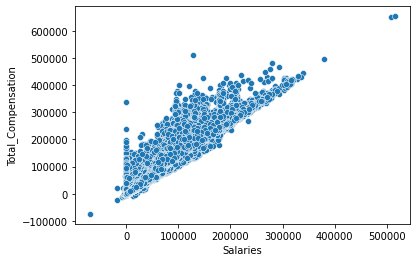

In [ ]:
sns.scatterplot(x=df.Salaries,y=df.Total_Compensation)

In [ ]:
group.columns

Index(['Year', 'OGC', 'UC', 'EI', 'Salaries', 'Overtime', 'H/D',
       'Total_Compensation'],
      dtype='object')

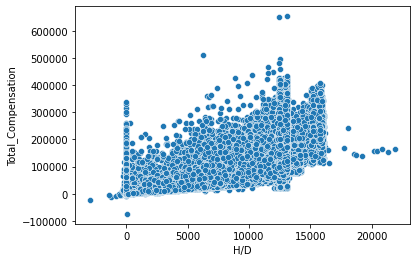

In [ ]:
sns.scatterplot(x=df['H/D'],y=df.Total_Compensation)

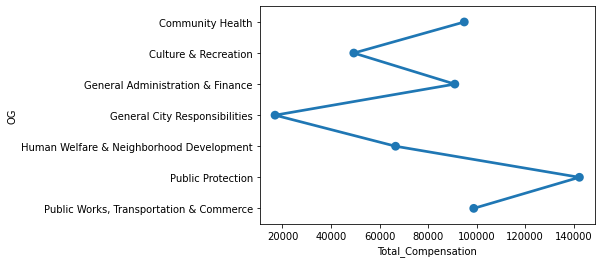

In [ ]:
sns.pointplot(y=group.index,x=group.Total_Compensation)

In [ ]:
group2=df.groupby('YT').mean()
group2

,Year,OGC,UC,EI,Salaries,Overtime,H/D,Total_Compensation
YT,,,,,,,,
Calendar,2013.950078,2.970731,489.956821,26908.396329,63589.132985,4392.714443,8981.534174,98638.331745
Fiscal,2014.549823,2.981045,490.959052,26919.250104,62959.201563,4409.558642,8886.929941,97373.875554


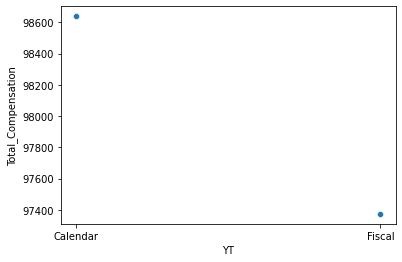

In [ ]:
sns.scatterplot(x=group2.index,y=group2.Total_Compensation,)

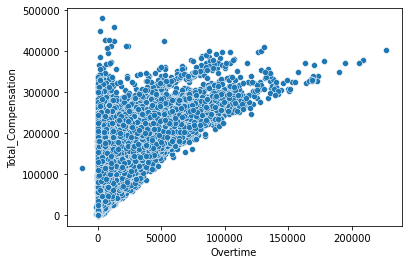

In [ ]:
sns.scatterplot(x=df.Overtime,y=df.Total_Compensation)

In [ ]:
df.corr()

,Year,OGC,UC,EI,Salaries,Overtime,H/D,Total_Compensation
Year,1.000000,-0.006071,-0.003762,0.001886,0.004696,0.015089,-0.013391,0.006309
OGC,-0.006071,1.000000,-0.006263,0.002011,-0.217594,-0.303153,-0.232939,-0.270031
UC,-0.003762,-0.006263,1.000000,-0.001502,-0.047414,0.059783,-0.073324,-0.032358
EI,0.001886,0.002011,-0.001502,1.000000,-0.004097,-0.001052,-0.003179,-0.003667
Salaries,0.004696,-0.217594,-0.047414,-0.004097,1.000000,0.271418,0.774855,0.972587
Overtime,0.015089,-0.303153,0.059783,-0.001052,0.271418,1.000000,0.312348,0.453364
H/D,-0.013391,-0.232939,-0.073324,-0.003179,0.774855,0.312348,1.000000,0.806266
Total_Compensation,0.006309,-0.270031,-0.032358,-0.003667,0.972587,0.453364,0.806266,1.000000


In [ ]:
newdf=df[['OGC','Salaries','H/D','Overtime','Total_Compensation']]
newdf.head()

,OGC,Salaries,H/D,Overtime,Total_Compensation
0,4,12196,0.00,0,16158
1,4,74639,12703.31,2820,115784
2,6,100554,12424.50,0,144708
3,1,140164,13043.87,52754,242323
4,2,58813,7655.28,0,82106


In [ ]:
dummies=pd.get_dummies(newdf.OGC,prefix='OGC')
dummies.head()

,OGC_1,OGC_2,OGC_3,OGC_4,OGC_5,OGC_6,OGC_7
0,0,0,0,1,0,0,0
1,0,0,0,1,0,0,0
2,0,0,0,0,0,1,0
3,1,0,0,0,0,0,0
4,0,1,0,0,0,0,0


In [ ]:
newdf=pd.concat([newdf,dummies],axis=1)
newdf.drop('OGC',axis=1,inplace=True)

In [ ]:
newdf.head()

,Salaries,H/D,Overtime,Total_Compensation,OGC_1,OGC_2,OGC_3,OGC_4,OGC_5,OGC_6,OGC_7
0,12196,0.00,0,16158,0,0,0,1,0,0,0
1,74639,12703.31,2820,115784,0,0,0,1,0,0,0
2,100554,12424.50,0,144708,0,0,0,0,0,1,0
3,140164,13043.87,52754,242323,1,0,0,0,0,0,0
4,58813,7655.28,0,82106,0,1,0,0,0,0,0


In [ ]:
x=newdf.drop('Total_Compensation',axis=1)
y=newdf.Total_Compensation

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression,LinearRegression
lreg=LinearRegression()

In [ ]:
xtrain, xtest, ytrain, ytest=train_test_split(x,y,test_size=0.2,random_state=0)

In [ ]:
lreg.fit(xtrain,ytrain)
lreg.score(xtest,ytest)

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_split.py:680: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  UserWarning,


### 3. Obesity Trends

---

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab import files
files.upload()

Saving obesity.csv to obesity.csv


{'obesity.csv': b'YearStart,YearEnd,LocationAbbr,LocationDesc,Datasource,Class,Topic,Question,Data_Value_Unit,Data_Value_Type,Data_Value,Data_Value_Alt,Data_Value_Footnote_Symbol,Data_Value_Footnote,Low_Confidence_Limit,High_Confidence_Limit ,Sample_Size,Total,Age(years),Education,Gender,Income,Race/Ethnicity,GeoLocation,ClassID,TopicID,QuestionID,DataValueTypeID,LocationID,StratificationCategory1,Stratification1,StratificationCategoryId1,StratificationID1\n2011,2011,AL,Alabama,Behavioral Risk Factor Surveillance System,Obesity / Weight Status,Obesity / Weight Status,Percent of adults aged 18 years and older who have obesity,,Value,32.0,32.0,,,30.5,33.5,7304,Total,,,,,,"(32.84057112200048, -86.63186076199969)",OWS,OWS1,Q036,VALUE,01,Total,Total,OVR,OVERALL\n2011,2011,AL,Alabama,Behavioral Risk Factor Surveillance System,Obesity / Weight Status,Obesity / Weight Status,Percent of adults aged 18 years and older who have obesity,,Value,32.3,32.3,,,29.9,34.7,2581,,,,Male,,,"(32.840571122000

In [ ]:
df=pd.read_csv('obesity.csv')
df.head()

,YearStart,YearEnd,LocationAbbr,LocationDesc,Datasource,Class,Topic,Question,Data_Value_Unit,Data_Value_Type,...,GeoLocation,ClassID,TopicID,QuestionID,DataValueTypeID,LocationID,StratificationCategory1,Stratification1,StratificationCategoryId1,StratificationID1
0,2011,2011,AL,Alabama,Behavioral Risk Factor Surveillance System,Obesity / Weight Status,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,NaN,Value,...,"(32.84057112200048, -86.63186076199969)",OWS,OWS1,Q036,VALUE,1,Total,Total,OVR,OVERALL
1,2011,2011,AL,Alabama,Behavioral Risk Factor Surveillance System,Obesity / Weight Status,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,NaN,Value,...,"(32.84057112200048, -86.63186076199969)",OWS,OWS1,Q036,VALUE,1,Gender,Male,GEN,MALE
2,2011,2011,AL,Alabama,Behavioral Risk Factor Surveillance System,Obesity / Weight Status,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,NaN,Value,...,"(32.84057112200048, -86.63186076199969)",OWS,OWS1,Q036,VALUE,1,Gender,Female,GEN,FEMALE
3,2011,2011,AL,Alabama,Behavioral Risk Factor Surveillance System,Obesity / Weight Status,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,NaN,Value,...,"(32.84057112200048, -86.63186076199969)",OWS,OWS1,Q036,VALUE,1,Education,Less than high school,EDU,EDUHS
4,2011,2011,AL,Alabama,Behavioral Risk Factor Surveillance System,Obesity / Weight Status,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,NaN,Value,...,"(32.84057112200048, -86.63186076199969)",OWS,OWS1,Q036,VALUE,1,Education,High school graduate,EDU,EDUHSGRAD


In [ ]:
df.drop(['YearEnd', 'LocationAbbr', 'Datasource',
       'Topic', 'Data_Value_Unit', 'Data_Value_Type',
        'Data_Value_Alt', 'Data_Value_Footnote_Symbol',
       'Data_Value_Footnote','Sample_Size', 'Total',
       'Race/Ethnicity', 'GeoLocation', 'ClassID', 'TopicID', 'QuestionID',
       'DataValueTypeID', 'LocationID', 'StratificationCategory1',
       'Stratification1', 'StratificationCategoryId1', 'StratificationID1'],1,inplace=True)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  import sys


In [ ]:
df.columns

Index(['YearStart', 'LocationDesc', 'Class', 'Question', 'Data_Value',
       'Low_Confidence_Limit', 'High_Confidence_Limit ', 'Age(years)',
       'Education', 'Gender', 'Income'],
      dtype='object')

In [ ]:
df.drop_duplicates(inplace=True)

In [ ]:
df.isna().sum()

YearStart                     0
LocationDesc                  0
Class                         0
Question                      0
Data_Value                 1856
Low_Confidence_Limit       1856
High_Confidence_Limit      1856
Age(years)                38752
Education                 42562
Gender                    46376
Income                    36841
dtype: int64

In [ ]:
for i in df.columns:
  if df[i].isna().sum()>36000:
    df.drop(i,1,inplace=True)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
for i in df.columns:
  if df[i].isna().sum()>0:
    df=df[df[i].notna()]
    

In [ ]:
df.isna().sum()

YearStart                 0
LocationDesc              0
Class                     0
Question                  0
Data_Value                0
Low_Confidence_Limit      0
High_Confidence_Limit     0
dtype: int64

In [ ]:
df.head()

,YearStart,LocationDesc,Class,Question,Data_Value,Low_Confidence_Limit,High_Confidence_Limit
0,2011,Alabama,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,32.0,30.5,33.5
1,2011,Alabama,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,32.3,29.9,34.7
2,2011,Alabama,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,31.8,30.0,33.6
3,2011,Alabama,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,33.6,29.9,37.6
4,2011,Alabama,Obesity / Weight Status,Percent of adults aged 18 years and older who ...,32.8,30.2,35.6


In [ ]:
df.YearStart.unique()

array([2011, 2012, 2014, 2013, 2015, 2016])

In [ ]:
df.Question.unique()

array(['Percent of adults aged 18 years and older who have obesity',
       'Percent of adults aged 18 years and older who have an overweight classification',
       'Percent of adults who report consuming fruit less than one time daily',
       'Percent of adults who report consuming vegetables less than one time daily',
       'Percent of adults who engage in muscle-strengthening activities on 2 or more days a week',
       'Percent of adults who achieve at least 150 minutes a week of moderate-intensity aerobic physical activity or 75 minutes a week of vigorous-intensity aerobic activity (or an equivalent combination)',
       'Percent of adults who achieve at least 150 minutes a week of moderate-intensity aerobic physical activity or 75 minutes a week of vigorous-intensity aerobic physical activity and engage in muscle-strengthening activities on 2 or more days a week',
       'Percent of adults who achieve at least 300 minutes a week of moderate-intensity aerobic physical activity 

In [ ]:
df=df[df.Question=='Percent of adults aged 18 years and older who have obesity']

In [ ]:
df.drop(['Class','Question'],1,inplace=True)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  """Entry point for launching an IPython kernel.


In [ ]:
df.drop_duplicates(inplace=True)
len(df)

8122

In [ ]:
df.reset_index(drop=True, inplace=True)

In [ ]:
df_grouped=df.groupby(['LocationDesc','YearStart']).mean().reset_index()
df_grouped

,LocationDesc,YearStart,Data_Value,Low_Confidence_Limit,High_Confidence_Limit
0,Alabama,2011,31.940000,27.548000,37.040000
1,Alabama,2012,31.730769,27.523077,36.776923
2,Alabama,2013,33.020833,28.545833,37.937500
3,Alabama,2014,33.620000,29.460000,38.256000
4,Alabama,2015,36.152000,31.740000,40.920000
...,...,...,...,...,...
315,Wyoming,2012,25.545833,20.704167,31.212500
316,Wyoming,2013,28.276000,23.492000,33.760000
317,Wyoming,2014,29.956000,24.232000,36.948000
318,Wyoming,2015,29.652174,24.504348,35.404348


In [ ]:
from sklearn.model_selection import train_test_split
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.2,random_state=0)

In [ ]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression()

In [ ]:
from sklearn.preprocessing import LabelEncoder
lb=LabelEncoder()


In [ ]:
df_grouped.rename(columns = { 'YearStart':'Year',}, inplace = True)

In [ ]:
df_grouped['location']=lb.fit_transform(df_grouped.LocationDesc)


In [ ]:
x=df_grouped.drop('LocationDesc',1)
y=df_grouped.Data_Value
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.2,random_state=0)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  """Entry point for launching an IPython kernel.


In [ ]:
lr.fit(xtrain,ytrain)
lr.score(xtest,ytest)

1.0

# 4. House Price Prediction

In [ ]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
df=pd.read_csv('train.csv')
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [ ]:
dftest=pd.read_csv('test.csv')
dftest.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,...,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,...,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


In [ ]:
df.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [ ]:
dftest.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [ ]:
df.drop_duplicates(inplace=True)
len(df)

1460

In [ ]:
dftest.drop_duplicates(inplace=True)

In [ ]:
Nan_dict={}
for i in df.columns:
  if df[i].isna().sum()!=0:
    Nan_dict[i]=df[i].isna().sum()
Nan_dict

{'LotFrontage': 259,
 'Alley': 1369,
 'MasVnrType': 8,
 'MasVnrArea': 8,
 'BsmtQual': 37,
 'BsmtCond': 37,
 'BsmtExposure': 38,
 'BsmtFinType1': 37,
 'BsmtFinType2': 38,
 'Electrical': 1,
 'FireplaceQu': 690,
 'GarageType': 81,
 'GarageYrBlt': 81,
 'GarageFinish': 81,
 'GarageQual': 81,
 'GarageCond': 81,
 'PoolQC': 1453,
 'Fence': 1179,
 'MiscFeature': 1406}

In [ ]:
dtest_Nan_dict={}
for i in dftest.columns:
  if dftest[i].isna().sum()!=0:
    dtest_Nan_dict[i]=dftest[i].isna().sum()
dtest_Nan_dict

{'MSZoning': 4,
 'LotFrontage': 227,
 'Alley': 1352,
 'Utilities': 2,
 'Exterior1st': 1,
 'Exterior2nd': 1,
 'MasVnrType': 16,
 'MasVnrArea': 15,
 'BsmtQual': 44,
 'BsmtCond': 45,
 'BsmtExposure': 44,
 'BsmtFinType1': 42,
 'BsmtFinSF1': 1,
 'BsmtFinType2': 42,
 'BsmtFinSF2': 1,
 'BsmtUnfSF': 1,
 'TotalBsmtSF': 1,
 'BsmtFullBath': 2,
 'BsmtHalfBath': 2,
 'KitchenQual': 1,
 'Functional': 2,
 'FireplaceQu': 730,
 'GarageType': 76,
 'GarageYrBlt': 78,
 'GarageFinish': 78,
 'GarageCars': 1,
 'GarageArea': 1,
 'GarageQual': 78,
 'GarageCond': 78,
 'PoolQC': 1456,
 'Fence': 1169,
 'MiscFeature': 1408,
 'SaleType': 1}

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [ ]:
dftest.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1459 entries, 0 to 1458
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1459 non-null   int64  
 1   MSSubClass     1459 non-null   int64  
 2   MSZoning       1455 non-null   object 
 3   LotFrontage    1232 non-null   float64
 4   LotArea        1459 non-null   int64  
 5   Street         1459 non-null   object 
 6   Alley          107 non-null    object 
 7   LotShape       1459 non-null   object 
 8   LandContour    1459 non-null   object 
 9   Utilities      1457 non-null   object 
 10  LotConfig      1459 non-null   object 
 11  LandSlope      1459 non-null   object 
 12  Neighborhood   1459 non-null   object 
 13  Condition1     1459 non-null   object 
 14  Condition2     1459 non-null   object 
 15  BldgType       1459 non-null   object 
 16  HouseStyle     1459 non-null   object 
 17  OverallQual    1459 non-null   int64  
 18  OverallC

In [ ]:
df[['BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF']][df.BsmtExposure.isna()]

,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF
17,NaN,NaN,NaN,NaN,0,NaN,0,0,0
39,NaN,NaN,NaN,NaN,0,NaN,0,0,0
90,NaN,NaN,NaN,NaN,0,NaN,0,0,0
102,NaN,NaN,NaN,NaN,0,NaN,0,0,0
156,NaN,NaN,NaN,NaN,0,NaN,0,0,0
182,NaN,NaN,NaN,NaN,0,NaN,0,0,0
259,NaN,NaN,NaN,NaN,0,NaN,0,0,0
342,NaN,NaN,NaN,NaN,0,NaN,0,0,0
362,NaN,NaN,NaN,NaN,0,NaN,0,0,0
371,NaN,NaN,NaN,NaN,0,NaN,0,0,0


In [ ]:
fillna_NA=[
 'Alley',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'FireplaceQu',
 'GarageType',
 'GarageFinish',
 'GarageQual',
 'GarageCond',
 'PoolQC',
 'Fence',
 'MiscFeature']

In [ ]:
modelist=['MSZoning',
 'Utilities',
 'Exterior1st',
 'Exterior2nd',
 'KitchenQual',
 'Functional',
 'SaleType']

nalist=['GarageCars',
 'GarageArea', 
 'BsmtFinSF1',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'TotalBsmtSF',
 'BsmtFullBath',
 'BsmtHalfBath']

In [ ]:
df[['YearBuilt', 'YearRemodAdd','GarageYrBlt']].corr()

,YearBuilt,YearRemodAdd,GarageYrBlt
YearBuilt,1.000000,0.592855,0.825667
YearRemodAdd,0.592855,1.000000,0.642277
GarageYrBlt,0.825667,0.642277,1.000000


In [ ]:
df.GarageYrBlt.fillna(df.YearBuilt,inplace=True)
df.LotFrontage.fillna(df.LotFrontage.median(),inplace=True)
df.BsmtExposure[(df.BsmtExposure.isna()) & (df.BsmtCond.notna())].fillna('No',inplace=True)
for i in fillna_NA:
  df[i].fillna('NA',inplace=True)

df.Electrical.fillna(df.Electrical.mode()[0],inplace=True)
df.MasVnrType.fillna('None',inplace=True)
df.MasVnrArea.fillna(0,inplace=True)

In [ ]:
for i in modelist:
  dftest[i].fillna(dftest[i].mode()[0],inplace=True)

for i in nalist:
  dftest[i].fillna(0,inplace=True)

In [ ]:
dftest.GarageYrBlt.fillna(dftest.YearBuilt,inplace=True)
dftest.LotFrontage.fillna(dftest.LotFrontage.median(),inplace=True)
dftest.BsmtExposure[(dftest.BsmtExposure.isna()) & (dftest.BsmtCond.notna())].fillna('No',inplace=True)
for i in fillna_NA:
  dftest[i].fillna('NA',inplace=True)

dftest.Electrical.fillna(dftest.Electrical.mode()[0],inplace=True)
dftest.MasVnrType.fillna('None',inplace=True)
dftest.MasVnrArea.fillna(0,inplace=True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1460 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          1460 non-null   object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [ ]:
dftest.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1459 entries, 0 to 1458
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1459 non-null   int64  
 1   MSSubClass     1459 non-null   int64  
 2   MSZoning       1459 non-null   object 
 3   LotFrontage    1459 non-null   float64
 4   LotArea        1459 non-null   int64  
 5   Street         1459 non-null   object 
 6   Alley          1459 non-null   object 
 7   LotShape       1459 non-null   object 
 8   LandContour    1459 non-null   object 
 9   Utilities      1459 non-null   object 
 10  LotConfig      1459 non-null   object 
 11  LandSlope      1459 non-null   object 
 12  Neighborhood   1459 non-null   object 
 13  Condition1     1459 non-null   object 
 14  Condition2     1459 non-null   object 
 15  BldgType       1459 non-null   object 
 16  HouseStyle     1459 non-null   object 
 17  OverallQual    1459 non-null   int64  
 18  OverallC

In [ ]:
objectlist=[]
for i in df.columns:
  if df[i].dtype=='object':
    objectlist.append(i)

In [ ]:
objectlist_testset=[]
for i in dftest.columns:
  if dftest[i].dtype=='object':
    objectlist_testset.append(i)

In [ ]:
objectlist==objectlist_testset

True

In [ ]:
from sklearn.preprocessing import LabelEncoder
lb=LabelEncoder()

In [ ]:
for i in objectlist:
  lb.fit(df[i])
  df[i]=lb.transform(df[i])
  dftest[i]=lb.transform(dftest[i])


In [ ]:
x=df.drop(['Id', 'MSSubClass','SalePrice'],1)
y=df.SalePrice

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  """Entry point for launching an IPython kernel.


In [ ]:
from sklearn.ensemble import RandomForestRegressor
rfg=RandomForestRegressor()

In [ ]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression()

In [ ]:
rfg.fit(x,y)

RandomForestRegressor()

In [ ]:
rfg.score(x,y)

0.9807167234583457

In [ ]:
lr.fit(x,y)
lr.score(x,y)

0.8529601750235423

In [ ]:
xtest=dftest.drop(['Id', 'MSSubClass',],1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  """Entry point for launching an IPython kernel.


In [ ]:
dftest['SalePrice']=lr.predict(xtest)

In [ ]:
output=dftest[['Id','SalePrice']]
output.to_csv('Output.csv')